In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import os
import sys
import copy
import cv2
import time
import numpy as np
import tabulate
import matplotlib.pyplot as plt
sys.path.append(os.path.join(os.path.abspath(""), ".."))

from app.utils import ImageWrapper
from app.custom import RemoveBusBars, Orient, BusbarMask
from app.transforms import FFT, IFFT, CreateOnesMask, PCA, DownsampleBlur, MaskedFFT
from app.filters import *
from app.imager import ImageLoader, DefectViewer, Show, Exposure

from app.models import Classifier
from sklearn.linear_model import LogisticRegression

In [3]:
## Notebook Utils

from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA as sk_PCA
from sklearn.manifold import TSNE
from matplotlib.lines import Line2D
import pandas as pd

# Plot 
def plot_comparison(reduced_clean, reduced_others, clean_labels, others_labels):
    
    reduced_clean = do_TSNE(reduced_clean)
    reduced_others = do_TSNE(reduced_others)
    
    clean_df = pd.DataFrame({'label':clean_labels})
    others_df = pd.DataFrame({'label':others_labels})
    
    colors = {'closed':'tab:blue', 'clean':'tab:orange', 'all_others':'tab:green'}
    
    
    from matplotlib.lines import Line2D
    fig, axs = plt.subplots(nrows=1,ncols=2, figsize=(12, 6))
    axs[0].scatter(reduced_clean[:,0], reduced_clean[:,1], c=clean_df['label'].map(colors), alpha=0.5)
    axs[0].set_title('Closed vs Clean')

    axs[1].scatter(reduced_others[:,0], reduced_others[:,1], c=others_df['label'].map(colors), alpha=0.3)
    handles = [Line2D([0], [0], marker='o', color='w', markerfacecolor=v, label=k, markersize=8) for k, v in colors.items()]
    axs[1].legend(title='Legend', handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')
    axs[1].set_title('Closed vs All Others')
    plt.show()
    
def do_TSNE(input_matrix):
    
    tsne_reduced = TSNE(n_components=2, perplexity=10).fit_transform(input_matrix)
    
    return tsne_reduced

## Build some pipeline functions:
def closed_pipeline(in_imgs, steps, cat):
    
    if steps == 1:
        _, out_class =  (Exposure('stretch') << (Sato(sigmas=[1,2]) <<  in_imgs))
        out_class.category=f"{cat}"
    
    elif steps == 2:
        _, out_class = (ThresholdMultiotsu(classes=4, threshold=1, digitize=False)) \
            << (Exposure('stretch') << (Sato(sigmas=[1,2]) <<  in_imgs))
        out_class.category=f"{cat}"
        
    elif steps == 3:
        _, out_class = (Exposure('mean_norm') << (MaskedFFT(mask=cross, window=False) \
                << (ThresholdMultiotsu(classes=4, threshold=1, digitize=False) \
                    << (Exposure('stretch') << (Sato(sigmas=[1,2]) <<  in_imgs)))))
        out_class.category=f"{cat}"
    
    return out_class

def prepare_lists(obj_lists):
    labels = []

    # process labels. 
    for obj in obj_lists:
        [labels.append(obj.category) for x in range(len(obj.image_labels))]
        
        # process images
    img_list = []
    [img_list.append(obj.images) for obj in obj_lists]
    
    img_matrix = np.vstack(img_list)
    
    # Stack all images
    img_matrix_ = img_matrix.reshape(img_matrix.shape[0], img_matrix.shape[1] * img_matrix.shape[2])
    
    return img_matrix_, labels

# Seed used in show to show the same images when num_images option is set
seed = 1234

# Utility function for plotting during this EDA:
def plot_10(in_imgs):
    fig, axs = plt.subplots(2,5, figsize=(15, 6))
    fig.subplots_adjust(hspace = .5, wspace=.001)
    axs = axs.ravel()
    for i in range(10):
        axs[i].imshow(in_imgs[i], cmap='Greys_r')
        axs[i].set_title(f'{i}')
        
# Function to make masks
def create_mask(half_width, shape, mtype):
    
  # Create a vertical mask
    if mtype == 'vertical':
        in_mask = np.zeros(shape)
        midpoint = in_mask.shape[1] // 2
        top_left = (midpoint - half_width, 0)
        bottom_right = (midpoint + half_width, shape[0])
        cv2.rectangle(in_mask, top_left, bottom_right, (255, 255, 255), -1)[0]
        in_mask = in_mask / 255
        
  # Create a horizontal mask
    if mtype == 'horizontal':
        in_mask = np.zeros(shape)
        midpoint = in_mask.shape[0] // 2
        top_left = (0, midpoint - half_width)
        bottom_right = (shape[1], midpoint + half_width)
        cv2.rectangle(in_mask, top_left, bottom_right, (255, 255, 255), -1)[0]
        in_mask = in_mask / 255
        
    return in_mask

def get_n_samples(n_samples):
    """
    returns at least N samples of the closed class. Wraps the imager classes. 
    """
    
    closed = (DefectViewer() << (ImageLoader(defect_class='Closed') << n_samples))
    closed.category = 'Closed'
    clean = (DefectViewer() << (ImageLoader(defect_class='None') << n_samples))
    clean.category = 'Clean'
    all_others = (DefectViewer() << (ImageLoader(defect_class=['Resistive', 'Isolated', 'Corrosion', 'FrontGridInterruption', 'BrightSpot', 'NearSolderPad']) << n_samples))
    all_others.category = 'all_others'
    
    #  remove any duplicates in the sets, since filenames with multiple annotations
    # have been included in different sets. 
    closed_ = closed.copy()
    closed = closed - all_others
    all_others = all_others - closed_
    clean = clean - closed_
    
    return closed, clean, all_others
    
## Stack images
def stack_images(obj_lists):
    """
    stack a matrix with dim N images, H and W with dim (N, H, W) to
    a stack of images with dim (N, H x W)
    """
    
    #get number of images
    n_samples = obj_lists[0].images.shape[0]
    
    # Process labels
    labels = []
    for obj in obj_lists:
        [labels.append(obj.category) for x in range(n_samples)]
        
    img_list = []
    [img_list.append(obj.images) for obj in obj_lists]
    img_matrix = np.vstack(img_list)
    
    return img_matrix, labels

## Plot Classifier Summary:
def plot_classifier_summary(scores, titles, model_type):

    fig, ax = plt.subplots()

    xrange = range(1, 1+len(scores[0]))
    ax.scatter((xrange), [x*100 for x in scores[0]], label='vs. All Others')
    ax.scatter((xrange), [x*100 for x in scores[1]], label='vs. Clean')
    ax.set_xticks(xrange, titles, rotation=70)
    ax.set_ylabel('Balanced Accuracy Score [%]')
    ax.legend(loc='lower left')
    ax.set_title(f'Balanced Accuracy Score vs Transform\n{model_type}')
    
class misclass:
    """Shell class to replicate the imager class functionalty"""
    def __init__(self, images, labels, category):
        self.images = images
        self.image_labels = labels
        self.category = category

def resize_chop(images):
    resize_shape=(224, 224) 
    chop=(0, 0)
    images = [cv2.resize(x, resize_shape, interpolation=cv2.INTER_CUBIC) for x in images]
    images = [x[chop[1]:-(chop[1] + 1), chop[0]:-(chop[0] + 1)] for x in images]
    images = np.stack(images, axis=0)
    images = images / 255.0
    return images

def load_misclass(misclassed_obj):
    """Loads a list of filenames fro mthe output misclassified class"""
    images_FP = []
    images_FN = []
    out_lists = [images_FP, images_FN]
    loc_string = '../data/images/train/'
    
    #Unpack Wrapper
    FalsePositives, FalseNegatives = misclassed_obj
    
    #Loop looading images
    i=0
    for im_list in [FalsePositives, FalseNegatives]:
        # get fnames
        fname_list = im_list[0].image_labels
        for fname in fname_list:
            #load image
            im = cv2.cvtColor(cv2.imread(loc_string+fname), cv2.COLOR_BGR2GRAY)
            out_lists[i].append(im)
        i += 1
    
    images_FP = resize_chop(images_FP)
    images_FN = resize_chop(images_FN)
        
    # Convert to array
    FalsePositives_images = np.stack((x for x in images_FP), axis=0)
    FalseNegatives_images = np.stack((x for x in images_FN), axis=0)
    
    FP = misclass(FalsePositives_images, FalsePositives[0].image_labels, 'False Positive')
    FN = misclass(FalseNegatives_images, FalseNegatives[0].image_labels, 'False Negative')
    return FP, FN

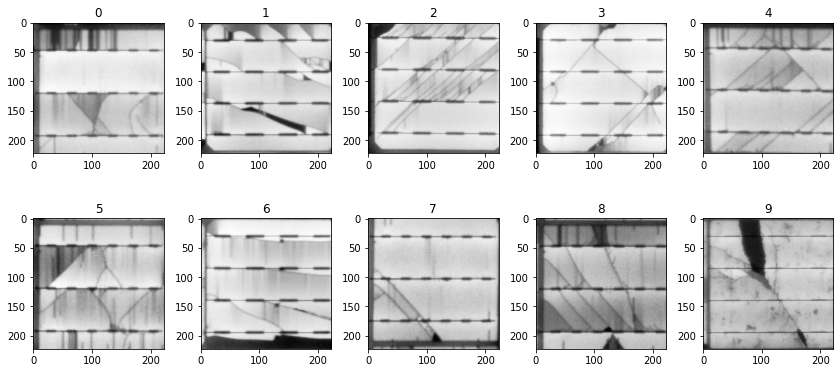

In [4]:
# Load 100 examples and name the category for it. Category is like a title for images
n_samples = 10
closed, clean, all_others = get_n_samples(n_samples)
plot_10(closed.images)

## EDA

### Description 

Isolated cracks are at their simplest thin dark likes which represent fractures in the cell wafer material. The shape of the crack is determined by the way the crack was created, and also the underlying properties of the wafer. For instance, if the wafer is multicrystalline, the cracks are generally lines which propagate in all directions, and are typically not smooth lines, since there is no underlying crystallographic plane to 'guide' the crack. 

Cracks in monocrystalline wafers are generally 'straighter', smoother lines which tend to propagate along diagonals in the wafer, due to the way that wafers are sliced along the < 1 0 0 > plane. 

Unlike isolated and resistive cracks, these cracks are characterised by the crack line only, and do not cause any isolated dark regions (isolated) or gradients (resistive) which emanate adjacent to the crack line.

Therefore we need to design filters to extract dark thin lines from the image in such a way that distinguishes from other dark features, like the isolated cracks and busbars. 

### Tested Approach

- Blur image and apply a filter such as the Sato, Frangi or Meijering filter to extract thin tube/vessel like structures. We also try a Farid edge detector. 
- Threshold out the crack lines 
- Remove any horizontal lines such as busbars which may be present. 

## Vesselness filters

In the following blocks we apply different vesselness filters with varying sigma's. Due to the different intensities of the output, we stretch the output values to 0-1. 

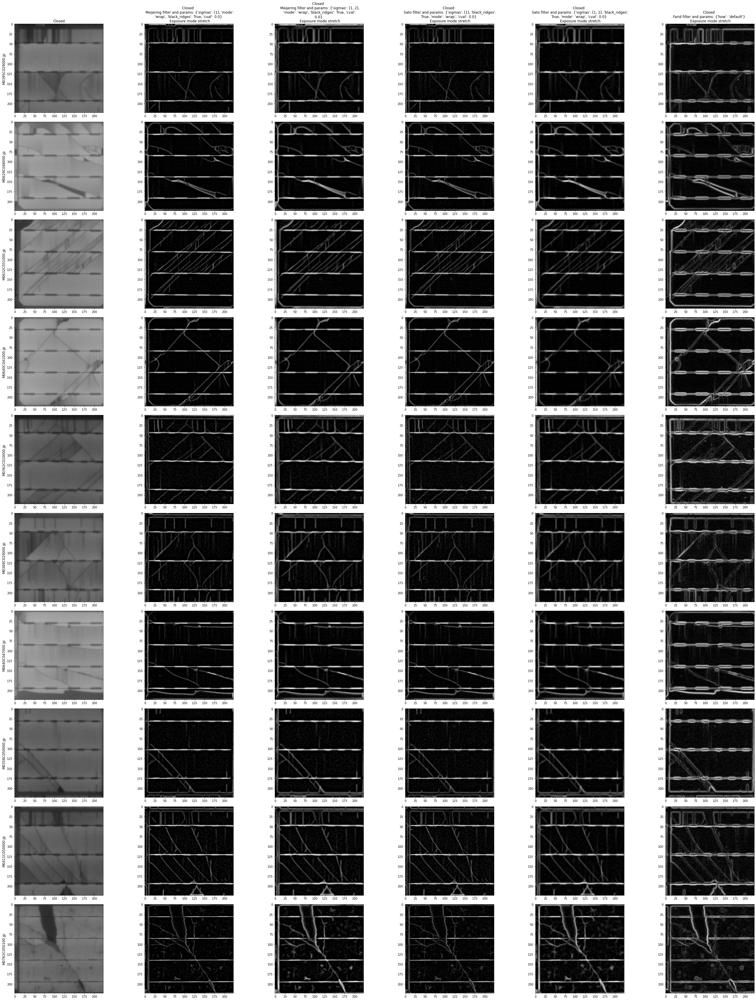

In [5]:
## Test different vesselness filters - sigma = 1,2,3 (note Farid is fixed for comparison)

_, meijering_1 = Exposure('stretch') << (Meijering(sigmas=[1]) <<  closed)
_, sato_1 = Exposure('stretch') <<(Sato(sigmas=[1]) <<  closed)
_, meijering_2 = Exposure('stretch') << (Meijering(sigmas=[1,2]) <<  closed)
_, sato_2 = Exposure('stretch') <<(Sato(sigmas=[1,2]) <<  closed)
_, farid = Exposure('stretch') << (Farid() <<  closed)
_ = Show(num_images=10, seed=seed) << (closed, meijering_1, meijering_2, sato_1, sato_2, farid)

#### Comments

- The farid filter is highly effective at detecting the edges, however it is almost picking up too much features and requires further filtering before application. This is particularly relevant for the multicrystalline cells, where it is filtering the grain boundaries and clusters.
- The sato and meijiring filters work well filtering the background texture from the cracks, and using sigma of 1 and 2 seems to be superior Using sigma = 1,2 and 3(not shown), and just 1 alone.
- Looking closely, the Sato filter with sigma's 1,2 tends to pick up less background noise than the meijering filter of the same parameters.

We will continue with the Sato filter but first explore the Frangi filter, which allows for a few more parameters to be tuned including:

- alpha: Frangi correction constant that adjusts the filter’s sensitivity to deviation from a plate-like structure. 
- beta: Frangi correction constant that adjusts the filter’s sensitivity to deviation from a blob-like structure.
- gamma: Frangi correction constant that adjusts the filter’s sensitivity to areas of high variance/texture/structure.

[source](https://scikit-image.org/docs/stable/api/skimage.filters.html#skimage.filters.frangi)

For comparison, we also try a Canny filter.

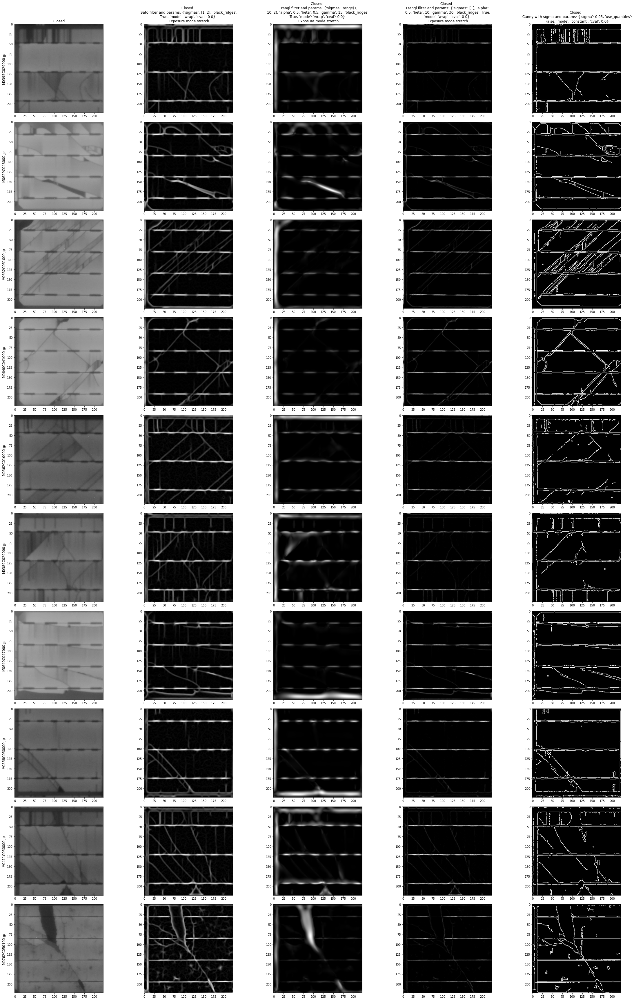

In [6]:
## Test different vesselness filters - sigma = 1,2 

_, sato = Exposure('stretch') <<(Sato(sigmas=[1,2]) <<  closed)
_, frangi_default = Exposure('stretch') <<(Frangi(sigmas=range(1,10,2)) <<  closed)
_, frangi_1 = Exposure('stretch') <<(Frangi(sigmas=[1], beta=10, gamma=30) <<  closed)
_, canny = (Canny(0.05) <<  closed)
_ = Show(num_images=10, seed=seed) << (closed, sato, frangi_default, frangi_1, canny)

### Evaluation

We find that the sato and meijering filters strike the best balance crack detection, background separation and sensitivity. Despite the additional parameters of the Frangi filter, we were not able to find good parameters which matched the performane of the Sato or Meijering filter. In comparison, the Canny filter required a very small sigma to be sensitive to the thin cracks, however doing so introduced a lot of noise.

### Issues - Horizontal and Vertical Lines

Vertical lines from the cell edges, or front grid interruptions and horizontal lines from the busars are being picked up. In the case of front grid interruptions, the removal of these may help improve performance of distinguishing between these two classes. 

There are two methods which can be trialled:

- FFT filtering the horizontal and vertical magnitudes from the FFT transformed image. 
- Using kernels and morphology functions in OpenCV2. 

#### Fourier Transform

We try a fourier transformed imagge whereby we try the following masks on the transformed magnitude:

- horizontal line - to target vertical frequencies in the image
- vertical line: targets horizontal lines in the image,
- A cross: both vertical and horizontal lines in the image

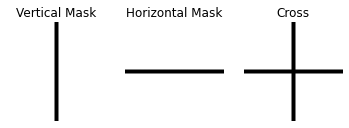

In [7]:
# Make masks
vertical = 1 - create_mask(4, closed.images[0].shape,'vertical')
horizontal = 1 - create_mask(4, closed.images[0].shape,'horizontal')
cross = vertical + horizontal - 1
cross[cross < 1] = 0

# Plot
_, axes = plt.subplots(nrows=1, ncols=3)
axes[0].imshow(vertical, cmap='gray')
axes[0].set_axis_off()
axes[0].set_title('Vertical Mask')
axes[1].imshow(horizontal, cmap='gray')
axes[1].set_axis_off()
_ = axes[1].set_title('Horizontal Mask')
axes[2].imshow(cross, cmap='gray')
axes[2].set_axis_off()
_ = axes[2].set_title('Cross')

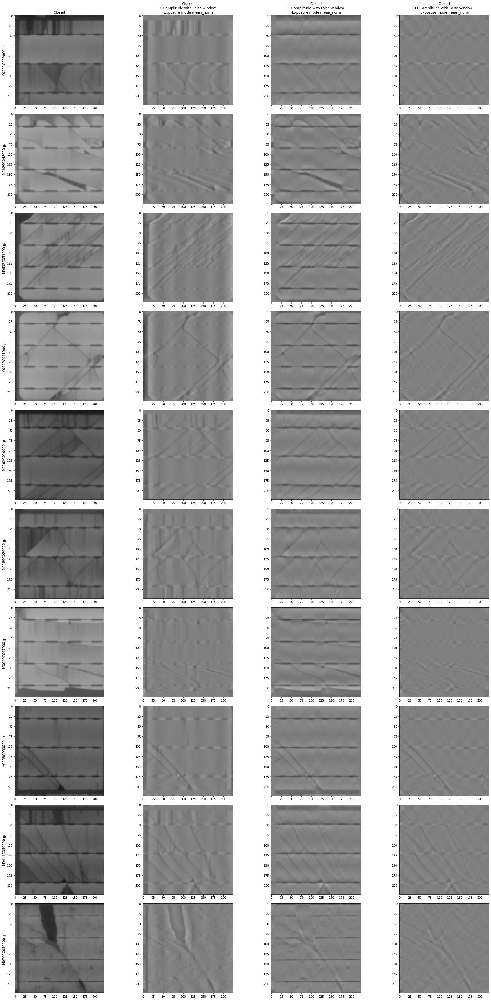

In [8]:
# Apply maks to FFT transformed image
_, vertical_ = (Exposure('mean_norm') << (MaskedFFT(mask=vertical, window=False) << closed))
_, horizontal_ = (Exposure('mean_norm') <<(MaskedFFT(mask=horizontal, window=False) << closed))
_, cross_ = (Exposure('mean_norm') << (MaskedFFT(mask=cross, window=False) << closed))
_ = Show(num_images=10, seed=seed) << (closed, vertical_, horizontal_, cross_)

The series of filters applied to the fourier magnitude have done a reasonable job of removing horizontal and vertical lines from the images. 

### Issue - Noise from multicrystalline 
We apply a multiotsu threshold filter in two ways - by thresholding and binarising the data, or by filtering based on the threshold levels. We observe that closed dark regions are often picked up in the image as these are bounded by edges. We try using a multiotsu filter to help isolate the crack lines without the inbetween fill.

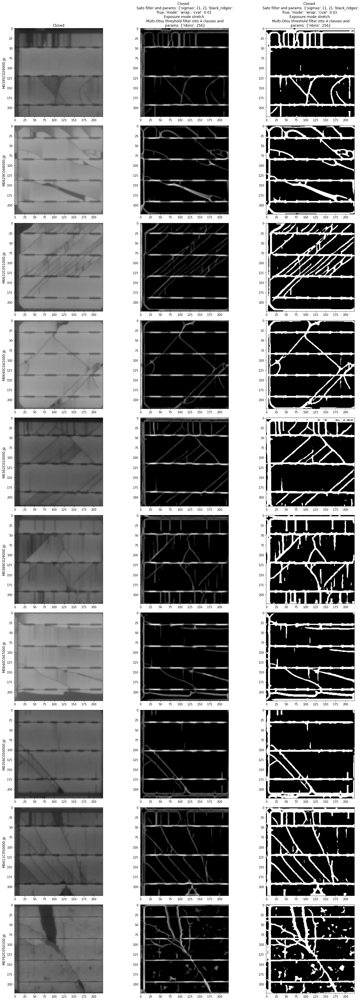

In [9]:
_, Thresholded_1 = ThresholdMultiotsu(classes=4, threshold=1, digitize=False) << (Exposure('stretch') <<(Sato(sigmas=[1,2]) <<  closed))
_, Thresholded_2 = ThresholdMultiotsu(classes=4, threshold=2) << (Exposure('stretch') <<(Sato(sigmas=[1,2]) <<  closed))

_ = Show(num_images=10, seed=seed) << (closed, Thresholded_1, Thresholded_2)

In the above images, we find that the mthod of thresholding and filtering the sato filtered image helps avoid the selection of features such as closed dark regions. 

## Putting it all together

We propose the following pipeline:

- Apply the sato filter to the image to highlight the vessel-like crack lines in the dataset. 
- Multiotsu threshold the image to filter the lowest level of signal, since this corresponds usually to background noise. 
- Filter out the busbars and vertical edges, to leave predominantly cracks behind. 

In the following code, we do two comparisons:
- the defect class vs no defects present, since this represents this represents in some respects the upper limit for performance. 
- the defect class vs all other classes, since in this comparison we compare how well the features are unique to the 'closed' class.

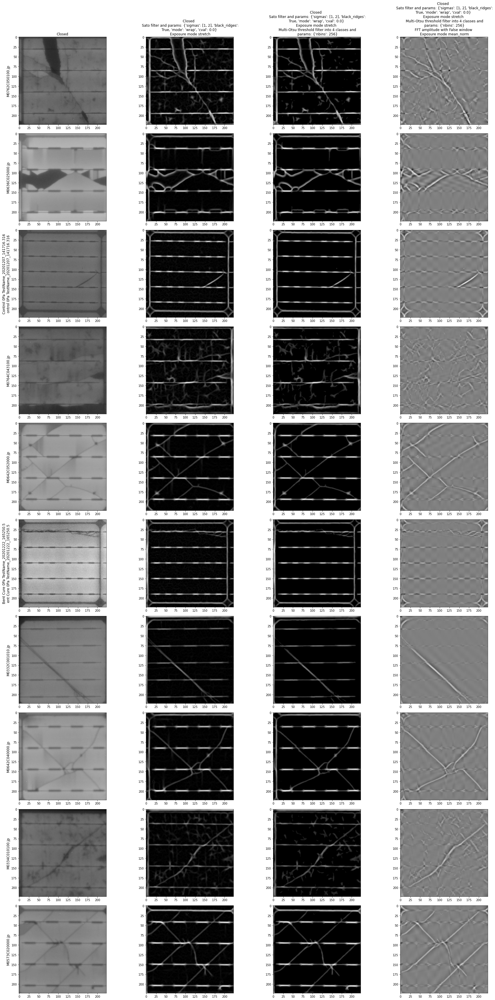

In [10]:
# Create mask
vertical = 1 - create_mask(6, closed.images[0].shape,'vertical')
horizontal = 1 - create_mask(6, closed.images[0].shape,'horizontal')
cross = vertical + horizontal - 1
cross[cross < 1] = 0
closed, _, _ = get_n_samples(40)

# Apply pipeline sequentially to show cumulative effect. 
_, sato_stretched =  (Exposure('stretch') << (Sato(sigmas=[1,2]) <<  closed))
_, sato_thresholded = (ThresholdMultiotsu(classes=4, threshold=1, digitize=False)) \
                                << (Exposure('stretch') << (Sato(sigmas=[1,2]) <<  closed))
_, sato_thresholded_fft = (Exposure('mean_norm') << (MaskedFFT(mask=cross, window=False) \
                                << (ThresholdMultiotsu(classes=4, threshold=1, digitize=False) \
                                << (Exposure('stretch') << (Sato(sigmas=[1,2]) <<  closed)))))

_ = Show(num_images=10, seed=seed) << (closed, sato_stretched, sato_thresholded, sato_thresholded_fft)

## Classifier Development

In this section, take a large number of samples and use these samples to develop our models. We validate on a subset of the training data, saving the test data for future validation. The code below prepares the data for this analysis.

In [11]:
# Get images
n_samples = 1200
closed_2000, clean_2000, all_others_2000 = get_n_samples(n_samples)
print('Samples loaded')

# Apply transforms sequentially
closed_sato =  closed_pipeline(closed_2000, 1, 'closed') # Sato 
closed_MO =  closed_pipeline(closed_2000, 2, 'closed') # Sato + Multi Otsu Thresholding
closed_fft  = closed_pipeline(closed_2000, 3, 'closed') # Sato + Multi Otsu Thresholding + FFT

# same as above but for the 'clean' class
clean_sato =  closed_pipeline(clean_2000, 1, 'clean')
clean_MO =  closed_pipeline(clean_2000, 2, 'clean')
clean_fft  = closed_pipeline(clean_2000, 3, 'clean')

# same as above but for the 'others class'
all_others_sato =  closed_pipeline(all_others_2000, 1, "all_others")
all_others_MO =  closed_pipeline(all_others_2000, 2, "all_others")
all_others_fft  = closed_pipeline(all_others_2000, 3, "all_others")  
print("transforms complete")

# Perform transforms on the relevant groups
# No transform
vclean_matrix, vclean_labels = prepare_lists([closed_2000, clean_2000])
vao_matrix, vao_labels = prepare_lists([closed_2000, all_others_2000])
# Sato Filtering
sclean_matrix, sclean_labels = prepare_lists([closed_sato, clean_sato])
sao_matrix, sao_labels = prepare_lists([closed_sato, all_others_sato])
# Sato + Thresholding
mclean_matrix, mclean_labels = prepare_lists([closed_MO, clean_MO])
mao_matrix, mao_labels = prepare_lists([closed_MO, all_others_MO])
# Sato + Thresholding + fft
fclean_matrix, fclean_labels = prepare_lists([closed_fft, clean_fft])
fao_matrix, fao_labels = prepare_lists([closed_fft, all_others_fft])
print('processing complete')

Samples loaded
transforms complete
processing complete


## TSNE Transformed Data

To get an indication on the classes within the data, we applied a TSNE algorithm to visualise the classes in 2 dimensional space. PCA was also evaluatated, but did not perform as well as PCA and is omitted. 

It is arguably hard to observe good separation, given our dataset, whereby:
 
- a closed crack may be a single crack line that distinguishes it from a 'clean' cell - thus hard to distinguish from a clean cell since the point of vaariance comprises only a small portion of the information in the image. 
- a closed crack may be present in accompaniament to other defects, hence it will be difficult to cluster relative to the 'all others' class.

Nevertheless, we proceed to visualise whether or transformations can assist with this separation.

### TSNE transform - raw data 

In [12]:
# format labels
vclean_labels = [x.lower() for x in vclean_labels]
vao_labels = [x.lower() for x in vao_labels]

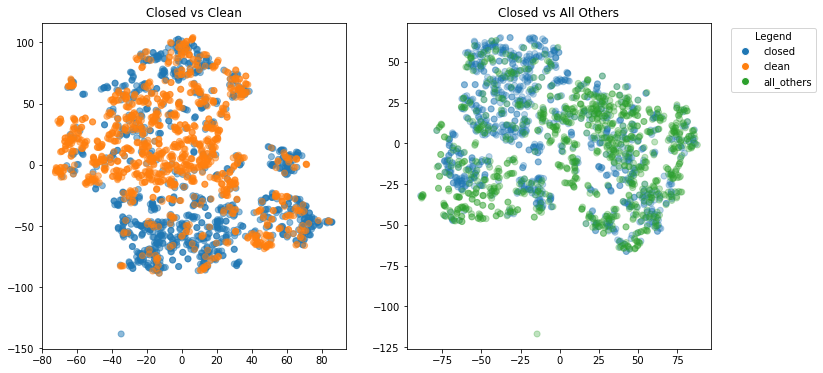

In [13]:
plot_comparison(vclean_matrix, vao_matrix, vclean_labels, vao_labels)

The data is not well clustered without filtering, as suspected, 

### TSNE Transformed Data - Sato Filter

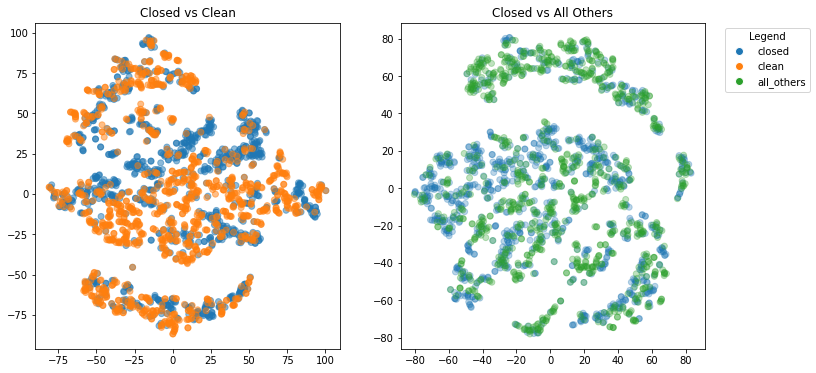

In [14]:
# Sato Filtering
plot_comparison(sclean_matrix, sao_matrix, sclean_labels, sao_labels)

compared to the base case, there is some regions of the clean and all_others class whic appear to be better separated from the bulk of the data, but there are still significant regions of overlap.

### TSNE Transformed Data - Sato + MultiOtsu Thresholding Filter

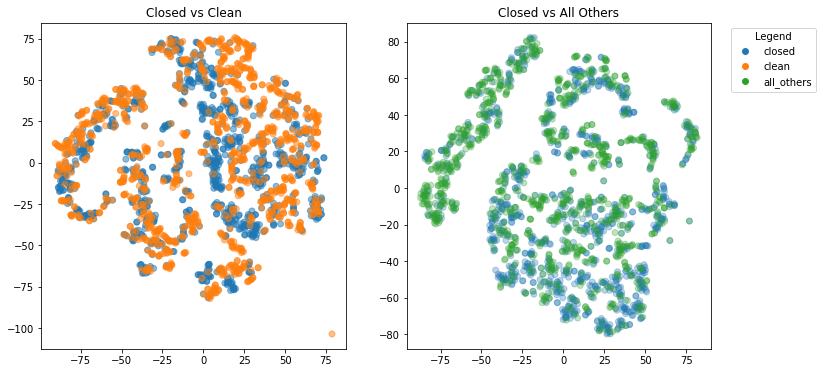

In [15]:
# Sato Filtering + Multiotsu Thresholding
plot_comparison(mclean_matrix, mao_matrix, mclean_labels, mao_labels)

No meaningful difference between this step and the last. 

### TSNE Transformed Data - Sato + MultiOtsu Thresholding + FFT Cross Filter

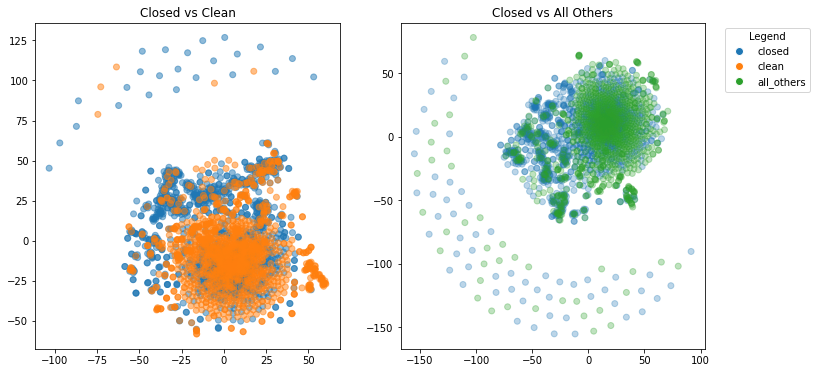

In [16]:
# Sato Filtering + MultiOtsu thresholding + FFT Cross Filter
plot_comparison(fclean_matrix, fao_matrix, fclean_labels, fao_labels)

From the above TSNE plots, we can see the the Sato and MultiOtsu threshold filters appear to increase the separation in the data. However the FFT transform appears to not help with the separation of the data, at least down to two dimensions, as it appears to have superimposed the clean/all_others data over the closed data cluster. 

In the following section, we train classification models, evaluating the step change in performance as the filters are introduced. 

## Classifier development

We test various classifiers at different stages of the pipelines. We test the following sequence of transformations:

- With/Without PCA performed on the data. 
- Classifiers: Logistic Regression, Kmeans, Gradient Boosting Algorithm 
- Data Splits: Defected vs Clean, Defected vs 'All Others' (including clean). 
- Transforms: Base model vs Sato Filtering, Sato + Multi Otsu Thresholding, Sato + MultiOtsu + FFT busbar and horizontal line removal.

We report [balanced accuracy score](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.balanced_accuracy_score.html) as the primary metric. 


#### Logistic Regression

In [17]:
# Write a function to parameterise the classifier search 
def loop_classifier(data, model_type, titles, model_params, return_misclassified=False):
    scores_list = []
    conf_list = []
    out_list = []
    
    # Run a classifier sweep on the transforms
    for i in range(len(titles)):
        cla = Classifier(data[i][0], data[i][1], model_type, None)
        score = cla.fit_cv(**model_params[i])

        print(f'\n{titles[i]}\n{score*100:.4f} %')
        scores_list.append(score)
        
        # Miscalssified 
        conf, out = cla.misclassified()
        conf_list.append(conf)
        out_list.append(out)
        print(tabulate.tabulate(
            [['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], 
            headers=['', 'Pred 0', 'Pred 1']))
        
    # Misclassified
    if return_misclassified:
        return scores_list, conf_list, out_list
    else:
        return scores_list

In [18]:
# Loop 
data_clean = ((closed_2000, clean_2000), (closed_2000, clean_2000), (closed_sato, clean_sato), (closed_MO, clean_MO), (closed_fft, clean_fft))
data_ao = ((closed_2000, all_others_2000), (closed_2000, all_others_2000), (closed_sato, all_others_sato), (closed_MO, all_others_MO), (closed_fft, all_others_fft))
model_type = LogisticRegression
model_string = 'Base Model'
titles = [f'{model_string} - No PCA', f'{model_string} w/PCA', f'{model_string} w/PCA  + Sato',
         f'{model_string} w/PCA  + Sato + Thresholding', f'{model_string} w/PCA  + Sato + Thresholding + fft']

# Write Params
pca_dims = [None, 800, 800, 800, 800]
model_params = [{'penalty': 'l2', 'seed': 4156, 'pca_dims': pca_dims[x], 'max_iter':400} for x in range(len(data_clean))]

# Run classifiers on clean vss all others
print('#------Results vs Clean------#')
scores_clean = loop_classifier(data_clean, model_type, titles, model_params, return_misclassified=False)
print('#------Results vs All Others------#')
scores_all_others = loop_classifier(data_ao, model_type, titles, model_params, return_misclassified=False)

#------Results vs Clean------#


/opt/conda/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(



Base Model - No PCA
79.1176 %
          Pred 0    Pred 1
------  --------  --------
True 0       208        32
True 1        58       146


/opt/conda/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(



Base Model w/PCA
79.6814 %
          Pred 0    Pred 1
------  --------  --------
True 0       206        34
True 1        54       150

Base Model w/PCA  + Sato
81.6789 %
          Pred 0    Pred 1
------  --------  --------
True 0       205        35
True 1        45       159

Base Model w/PCA  + Sato + Thresholding
82.8309 %
          Pred 0    Pred 1
------  --------  --------
True 0       207        33
True 1        42       162

Base Model w/PCA  + Sato + Thresholding + fft
68.5294 %
          Pred 0    Pred 1
------  --------  --------
True 0       196        44
True 1        91       113
#------Results vs All Others------#


/opt/conda/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(



Base Model - No PCA
66.1805 %
          Pred 0    Pred 1
------  --------  --------
True 0       136        67
True 1        71       134


/opt/conda/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(



Base Model w/PCA
66.9122 %
          Pred 0    Pred 1
------  --------  --------
True 0       136        67
True 1        68       137


/opt/conda/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(



Base Model w/PCA  + Sato
65.2145 %
          Pred 0    Pred 1
------  --------  --------
True 0       140        63
True 1        79       126


/opt/conda/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(



Base Model w/PCA  + Sato + Thresholding
65.4536 %
          Pred 0    Pred 1
------  --------  --------
True 0       138        65
True 1        76       129

Base Model w/PCA  + Sato + Thresholding + fft
59.6239 %
          Pred 0    Pred 1
------  --------  --------
True 0       148        55
True 1       110        95


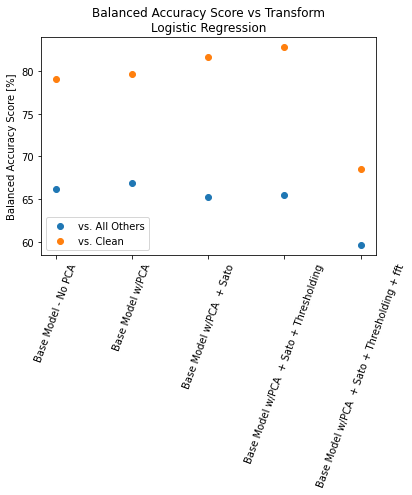

In [19]:
plot_classifier_summary((scores_all_others, scores_clean), titles, 'Logistic Regression')

#### Summary - Base Case

- The Sato + Thresholding steps have the greatest effect on the overall scores.  
- The FFT transform and masking step does not result in better classification scores.
- The transforms do not result in a significant improvement relative to the base classifier with/without PCA. 
- unsurprisingly, the model performance is poorer when distinguishing against all classes, compared to 'clean' cells. 

We also note that for many parameters, convergence was not reached, indicating that these results may be prone to variance. 

We try a few other classifiers before exploring in more detail where the model is failing.

#### KMeans

In [20]:
from sklearn.cluster import KMeans
data_clean = ((closed_2000, clean_2000), (closed_2000, clean_2000), (closed_sato, clean_sato), (closed_MO, clean_MO), (closed_fft, clean_fft))
data_ao = ((closed_2000, all_others_2000), (closed_2000, all_others_2000), (closed_sato, all_others_sato), (closed_MO, all_others_MO), (closed_fft, all_others_fft))

# Loop 
model_type = KMeans
model_string = 'KMeans'
titles = [f'{model_string} - No PCA', f'{model_string} w/PCA', f'{model_string} w/PCA  + Sato',
         f'{model_string} w/PCA  + Sato + Thresholding', f'{model_string} w/PCA  + Sato + Thresholding + fft']

# Write Params
pca_dims = [None, 800, 800, 800, 800]
model_params = [{'n_clusters':2, 'seed': 4156, 'pca_dims': pca_dims[x], 'max_iter':400} for x in range(len(data_clean))]

# Run classifiers on clean vss all others
print('#------Results vs Clean------#')
scores_clean = loop_classifier(data_clean, model_type, titles, model_params, return_misclassified=False)
print('#------Results vs All Others------#')
scores_all_others = loop_classifier(data_ao, model_type, titles, model_params, return_misclassified=False)

#------Results vs Clean------#

KMeans - No PCA
69.3260 %
          Pred 0    Pred 1
------  --------  --------
True 0       181        59
True 1        75       129

KMeans w/PCA
30.6740 %
          Pred 0    Pred 1
------  --------  --------
True 0        59       181
True 1       129        75

KMeans w/PCA  + Sato
49.4240 %
          Pred 0    Pred 1
------  --------  --------
True 0       149        91
True 1       129        75

KMeans w/PCA  + Sato + Thresholding
49.4240 %
          Pred 0    Pred 1
------  --------  --------
True 0       149        91
True 1       129        75

KMeans w/PCA  + Sato + Thresholding + fft
53.8725 %
          Pred 0    Pred 1
------  --------  --------
True 0       128       112
True 1        93       111
#------Results vs All Others------#

KMeans - No PCA
38.2290 %
          Pred 0    Pred 1
------  --------  --------
True 0        75       128
True 1       124        81

KMeans w/PCA
61.7710 %
          Pred 0    Pred 1
------  --------  ------

Initial results with Kmeans do not perform particularly well, which is perhaps unsurprising given the TSNE results. We perform a sweep below to assess whether this can be addressed with PCA. 

In [21]:
# Kmeans on raw data - single defect vs. clean
k_scores = []
k_titles = []

# Sweep different PCA Dims to search for maxima
for k in range(50, 1000, 50):
    model_params = {'n_clusters': 2, 'seed': 4156, 'pca_dims': k, 'max_iter':400}
    cla = Classifier(data_clean[3][0], data_clean[3][1], KMeans, None) #Test on Sato filtered + Multi Otsu thresholded data
    score = cla.fit_cv(**model_params)
    print(f"PCA Dims: {k}, Balanced Accuracy: {score*100:.4f} %")
    k_scores.append(score)
    k_titles.append(k)

PCA Dims: 50, Balanced Accuracy: 50.5760 %
PCA Dims: 100, Balanced Accuracy: 50.5760 %
PCA Dims: 150, Balanced Accuracy: 50.5760 %
PCA Dims: 200, Balanced Accuracy: 50.5760 %
PCA Dims: 250, Balanced Accuracy: 49.4240 %
PCA Dims: 300, Balanced Accuracy: 49.4240 %
PCA Dims: 350, Balanced Accuracy: 50.5760 %
PCA Dims: 400, Balanced Accuracy: 49.4240 %
PCA Dims: 450, Balanced Accuracy: 49.4240 %
PCA Dims: 500, Balanced Accuracy: 49.4240 %
PCA Dims: 550, Balanced Accuracy: 49.4240 %
PCA Dims: 600, Balanced Accuracy: 49.4240 %
PCA Dims: 650, Balanced Accuracy: 49.4240 %
PCA Dims: 700, Balanced Accuracy: 49.4240 %
PCA Dims: 750, Balanced Accuracy: 49.4240 %
PCA Dims: 800, Balanced Accuracy: 50.5760 %
PCA Dims: 850, Balanced Accuracy: 50.5760 %
PCA Dims: 900, Balanced Accuracy: 50.5760 %
PCA Dims: 950, Balanced Accuracy: 49.4240 %


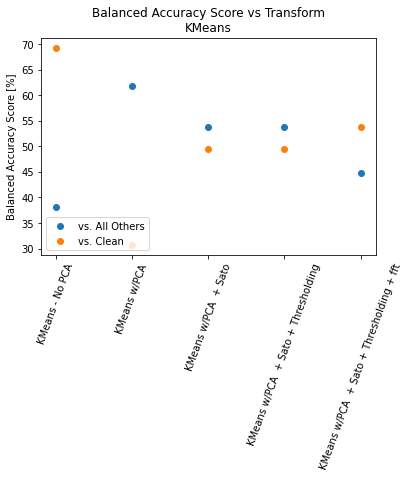

In [22]:
plot_classifier_summary((scores_all_others, scores_clean), titles, 'KMeans')

The KMeans algorithm does not appear to be able to effectively classify/cluster the data relative to the logistic regression base model.

### Gradient Boosting Classifer

#------Results vs Clean------#

Gradient Boosting Classifier w/PCA
82.2928 %
          Pred 0    Pred 1
------  --------  --------
True 0       215        27
True 1        49       153

Gradient Boosting Classifier w/PCA  + Sato
80.2758 %
          Pred 0    Pred 1
------  --------  --------
True 0       228        14
True 1        68       134

Gradient Boosting Classifier w/PCA  + Sato + Thresholding
79.3654 %
          Pred 0    Pred 1
------  --------  --------
True 0       220        22
True 1        65       137

Gradient Boosting Classifier w/PCA  + Sato + Thresholding + fft
71.4467 %
          Pred 0    Pred 1
------  --------  --------
True 0       226        16
True 1       102       100
#------Results vs All Others------#

Gradient Boosting Classifier w/PCA
68.8942 %
          Pred 0    Pred 1
------  --------  --------
True 0       141        67
True 1        60       140

Gradient Boosting Classifier w/PCA  + Sato
71.9519 %
          Pred 0    Pred 1
------  --------  ----

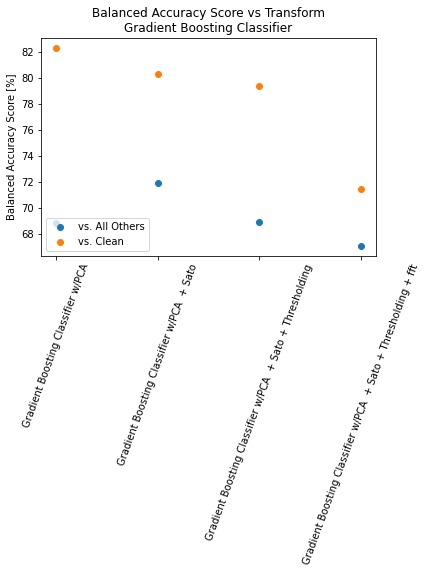

In [23]:
from sklearn.ensemble import GradientBoostingClassifier

data_clean = ((closed_2000, clean_2000), (closed_sato, clean_sato), (closed_MO, clean_MO), (closed_fft, clean_fft))
data_ao = ((closed_2000, all_others_2000), (closed_sato, all_others_sato), (closed_MO, all_others_MO), (closed_fft, all_others_fft))

# Loop 
model_type = GradientBoostingClassifier
model_string = 'Gradient Boosting Classifier'
titles = [f'{model_string} w/PCA', f'{model_string} w/PCA  + Sato',
         f'{model_string} w/PCA  + Sato + Thresholding', f'{model_string} w/PCA  + Sato + Thresholding + fft']

# Write Params
pca_dims = [800, 800, 800, 800]
model_params = [{'seed': 14376,'n_estimators': 300, 'max_depth': 4, 'learning_rate': 0.1, 'pca_dims': pca_dims[x]} for x in range(len(data_clean))]

# Run classifiers on clean vss all others
print('#------Results vs Clean------#')
scores_clean, conf, examples_cl = loop_classifier(data_clean, model_type, titles, model_params, return_misclassified=True)
print('#------Results vs All Others------#')
scores_all_others, conf, examples_ao = loop_classifier(data_ao, model_type, titles, model_params, return_misclassified=True)

plot_classifier_summary((scores_all_others, scores_clean), titles, 'Gradient Boosting Classifier')

/opt/conda/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3251: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  exec(code_obj, self.user_global_ns, self.user_ns)


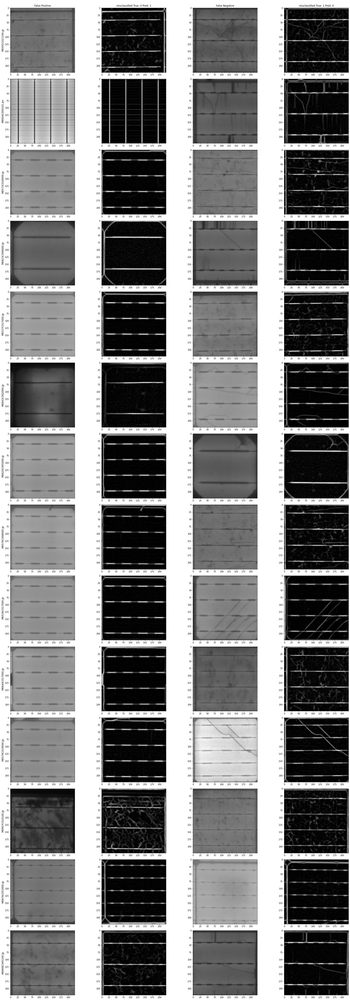

(<__main__.misclass at 0x7fb8f5e8c250>,
 <app.utils.ImageWrapper at 0x7fb8f5f19790>)

In [24]:
# View Sato filtered False Positives and False Negatives
Sato_FP, Sato_FN = examples_cl[1]
FP, FN = load_misclass(examples_cl[1])
Show(num_images=20, seed=seed) << (FP, Sato_FP[0], FN, Sato_FN[1])

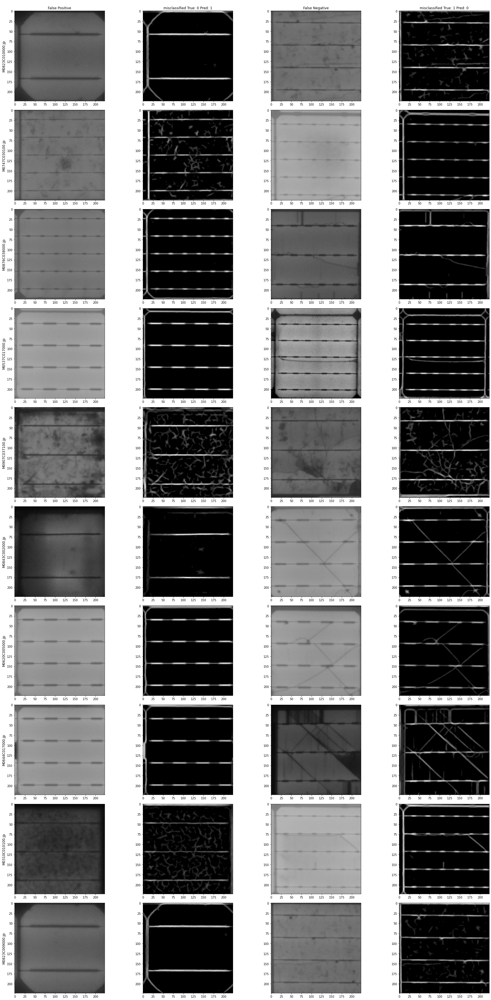

(<__main__.misclass at 0x7fb8f563b310>,
 <app.utils.ImageWrapper at 0x7fb8f5f19100>)

In [25]:
# View Sato
MO_FP, MO_FN = examples_cl[2]
FP, FN = load_misclass(examples_cl[2])
Show(num_images=10, seed=seed) << (FP, MO_FP[0], FN, MO_FN[1])

There are a few reasons for the False Positives and False Negatives:

False Positives:
- The edge border of the cell with it's rounded shape is difficult to distinguish from a crack line after filters. 
- The multicrystalline texture is sometimes rendered as a crack by the sato filter.

False Negatives
- The multicrystalline texture is perhaps confusing the classfier, as these are difficult to distinguish from cracks. 


#------Results vs Clean------#

Gradient Boosting Classifier w/PCA + FFT Cross Mask
77.5959 %
          Pred 0    Pred 1
------  --------  --------
True 0       233         9
True 1        83       119
#------Results vs All Others------#

Gradient Boosting Classifier w/PCA + FFT Cross Mask
61.6538 %
          Pred 0    Pred 1
------  --------  --------
True 0       140        68
True 1        88       112


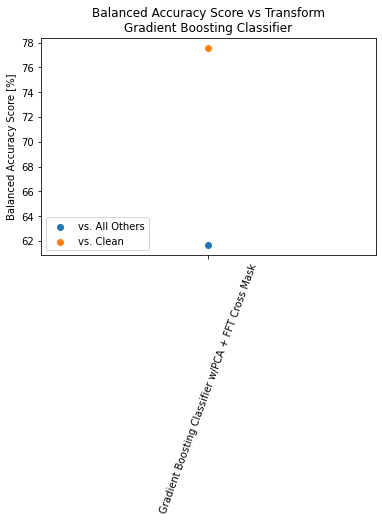

In [26]:
_, clean_fftmask = (Exposure('mean_norm') << (MaskedFFT(mask=cross, window=False) << clean_2000))
_, closed_fftmask = (Exposure('mean_norm') << (MaskedFFT(mask=cross, window=False) << closed_2000))
_, all_others_fftmask = (Exposure('mean_norm') << (MaskedFFT(mask=cross, window=False) << all_others_2000))

clean_fftmask.category='clean'
closed_fftmask.category='closed'
all_others_fftmask.category='all_others'

from sklearn.ensemble import GradientBoostingClassifier

data_clean = ((closed_fftmask, clean_fftmask),)
data_ao = ((closed_fftmask, all_others_fftmask),)
titles = [f'{model_string} w/PCA + FFT Cross Mask']

# Loop 
model_type = GradientBoostingClassifier
model_string = 'Gradient Boosting Classifier'

# Write Params
pca_dims = [800]
model_params = [{'seed': 14376,'n_estimators': 300, 'max_depth': 4, 'learning_rate': 0.1, 'pca_dims': 800}]

# Run classifiers on clean vss all others
print('#------Results vs Clean------#')
scores_clean, conf, examples_cl = loop_classifier(data_clean, model_type, titles, model_params, return_misclassified=True)
print('#------Results vs All Others------#')
scores_all_others, conf, examples_ao = loop_classifier(data_ao, model_type, titles, model_params, return_misclassified=True)

plot_classifier_summary((scores_all_others, scores_clean), titles, 'Gradient Boosting Classifier')

In [27]:
# Crop images
chop = (25,25)
for imgs in [closed_MO, clean_MO, all_others_MO]:
    imgs_cropped = [x[chop[1]:-(chop[1] + 1), chop[0]:-(chop[0] + 1)] for x in imgs.images]
    imgs.images = np.stack((x for x in imgs_cropped), axis=0)

/opt/conda/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3191: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  if await self.run_code(code, result, async_=asy):


#------Results vs Clean------#

Gradient Boosting Classifier w/PCA + Thresholding Cropped
77.6737 %
          Pred 0    Pred 1
------  --------  --------
True 0       219        23
True 1        71       131
#------Results vs All Others------#

Gradient Boosting Classifier w/PCA + Thresholding Cropped
71.0385 %
          Pred 0    Pred 1
------  --------  --------
True 0       152        56
True 1        62       138


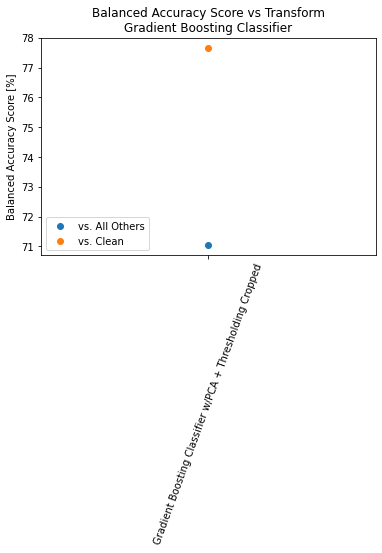

In [28]:
# Crop images
chop = (25,25)
for imgs in [closed_MO, clean_MO, all_others_MO]:
    [x[chop[1]:-(chop[1] + 1), chop[0]:-(chop[0] + 1)] for x in imgs.images] 

data_clean = ((closed_MO, clean_MO),)
data_ao = ((closed_MO, all_others_MO),)
titles = [f'{model_string} w/PCA + Thresholding Cropped']

# Loop 
model_type = GradientBoostingClassifier
model_string = 'Gradient Boosting Classifier'

# Write Params
pca_dims = [800]
model_params = [{'seed': 14376,'n_estimators': 300, 'max_depth': 4, 'learning_rate': 0.1, 'pca_dims': 800}]

# Run classifiers on clean vss all others
print('#------Results vs Clean------#')
scores_clean, conf, examples_cl = loop_classifier(data_clean, model_type, titles, model_params, return_misclassified=True)
print('#------Results vs All Others------#')
scores_all_others, conf, examples_ao = loop_classifier(data_ao, model_type, titles, model_params, return_misclassified=True)

plot_classifier_summary((scores_all_others, scores_clean), titles, 'Gradient Boosting Classifier')

### CNN

We now train a CNN to compare the accuracy of our model vs a neural network. The CNN has the following attributes:

- 1x input channel.
- Convolution: 2x20 channel convolutional layers, convolved using a 3x3 kernel. 
- Output layers: 2 x fully connected dense layers of length 300.  
- Optimiser: Stochastic Gradient Descent, Nesterov Algorithm and a LR of 0.001.
- Scheduler: Linear decay. 
- Predicting 2 output classes. 

In [29]:
from app.models import ModelNN

#Define Parameters
scores_vclean = []
legends_vclean = []
lr = 0.0001

# Loop 
model_string = 'CNN'
titles = [f'{model_string} w/PCA', f'{model_string} w/PCA  + Sato',
         f'{model_string} w/PCA  + Sato + Thresholding', f'{model_string} w/PCA  + Sato + Thresholding + fft']
# Set Parameters
data_clean = ((closed_2000, clean_2000), (closed_sato, clean_sato), (closed_MO, clean_MO), (closed_fft, clean_fft))

optimizer_params = {'name': 'sgd', 'lr': lr, 'nesterov': True, 'momentum': 0.9}
scheduler_params = {'lr_min': lr/100, 't_mul': 3}
model_params = {'num_output_classes': 2, 'channels': ((1, 5), (20, 3), (20, 3))}

# Loop
i=0
for data in data_clean:
    model = ModelNN(data[0], data[1], model_params, optimizer_params, scheduler_params, model_type='cnn')
    score = model.fit(num_epochs=20)
    print(f"{titles[i]}: {score:.2f}")
    scores_vclean.append(score)
    legends_vclean.append(titles[i])
    i+=1

In [ ]:

#Define Parameters
scores_vclean = []
legends_vclean = []
lr = 0.0001

# Loop 
model_string = 'CNN'
titles = [f'{model_string} w/PCA', f'{model_string} w/PCA  + Sato',
         f'{model_string} w/PCA  + Sato + Thresholding', f'{model_string} w/PCA  + Sato + Thresholding + fft']
# Set Parameters
data_ao = ((closed_2000, all_others_2000), (closed_sato, all_others_sato), (closed_MO, all_others_MO), (closed_fft, all_others_fft))

optimizer_params = {'name': 'sgd', 'lr': lr, 'nesterov': True, 'momentum': 0.9}
scheduler_params = {'lr_min': lr/100, 't_mul': 3}
model_params = {'num_output_classes': 2, 'channels': ((1, 5), (20, 3), (20, 3))}

# Loop
i=0
for data in data_ao:
    model = ModelNN(data[0], data[1], model_params, optimizer_params, scheduler_params, model_type='cnn')
    score = model.fit(num_epochs=20)
    print(f"{titles[i]}: {score:.2f}")
    scores_vclean.append(score)
    legends_vclean.append(titles[i])
    i+=1

In [ ]:
plot_classifier_summary((scores_vao, scores_vclean), titles, 'CNN')

Various filters and filtering algorithms were trialled to isolate closed cracks. These include:

- Applying a sato vesselness filter to highlight cracks
- Thresholding the image, to remove lower strength signals, and to accentuate the cracks from the background.
- Applying a cross shaped mask to the FFT magnitude and then transforming the image back to remove busbars and vertical lines. 

Chained sequences of these filters/transforms were applied, and a classifier comparing the accuracy of a binary classifer to classify isolated cracks vs a clean image or an isolated crack vs all other potential defects was also trialled. The following classifiers were used:

KMeans, Logistic Regression, CNN and Gradient Boosting Classifier. 

The best scores for each algorithm and the pipeline producing those scores are shown below. 

Results vs Clean:

| Isolated vs Clean   | **Best Score**      | **Transform** |
|---------------------|---------------------|----------:|
| KMeans              | PCA + Gaussian Blur |      65.4 |
| Logistic Regression | PCA                 |      81.7 |
| Gradient Boosting Classifier   | PCA + Gaussian Blur |      89.0 |
| CNN                 | PCA + Gaussian Blur |  **91.0** |

Results vs all other defects:

| **Isolated vs All Others**   | **Best Score**      | **Transform** |
|---------------------|---------------------|----------:|
| KMeans              | PCA + Gaussian Blur |      51.9 |
| Logistic Regression | PCA                 |      72.0 |
| Gradient Boosting Classifier | PCA                 |  **82.8** |
| CNN                 | PCA + Gaussian Blur |      82.0 |

An analysis of the misclassified images showed that the model struggled to distinguish the multicystalline defect clusters from genuine cracks. Similarly, the model also struggled to differentiate the cell boundaries from a crack. This could potentially be overcome with cropping/windowing the image, but no further gains in classifier accuracy were found. 

Future gains could potentially be realised by further revision of the dataset to ensure 